***IMPORTING NECESSARY LIBRARIES***

In [94]:
# Importing numpy for numerical operations, especially array handling
import numpy as np

# Importing PyTorch's core module
import torch

# Importing utilities from PyTorch to create datasets, load them in batches, and concatenate multiple datasets
from torch.utils.data import Dataset, DataLoader, ConcatDataset

# Importing glob to find all file paths matching a specified pattern (useful for loading datasets)
import glob

# Importing matplotlib for plotting data and visualizations
import matplotlib.pyplot as plt

# Importing confusion_matrix and accuracy_score from scikit-learn for model evaluation
from sklearn.metrics import confusion_matrix, accuracy_score

# Importing OpenCV (cv2) for image processing tasks like reading and transforming images
import cv2

# Importing random module to introduce randomness (e.g., for shuffling data or augmentations)
import random

# Importing sys to interact with the system (e.g., accessing command-line arguments or modifying the path)
import sys


In [95]:
# Creating an empty list to store images of brain tumors
tumor = []

# Defining the path to all .jpg images in the 'yes' folder (tumor images)
path = r'C:\Users\hp\Documents\GitHub\Brain-Tumor-Prediction\Images\yes\*.jpg'

# Iterating over all image file paths that match the pattern using glob
for f in glob.iglob(path):
    # Reading the image using OpenCV (default is BGR format)
    img = cv2.imread(f)
    
    # Resizing the image to 128x128 pixels for uniformity
    img = cv2.resize(img, (128, 128))
    
    # Splitting the image into its Blue, Green, and Red channels
    b, g, r = cv2.split(img)
    
    # Merging the channels back in the order Red, Green, Blue (to convert from BGR to RGB)
    img = cv2.merge([r, g, b])
    
    # Appending the processed image to the tumor list
    tumor.append(img)


In [96]:
# Creating an empty list to store images of healthy brains (no tumor)
healthy = []

# Defining the path to all .jpg images in the 'no' folder (healthy images)
path = r'C:\Users\hp\Documents\GitHub\Brain-Tumor-Prediction\Images\no\*.jpg'

# Iterating over all image file paths that match the pattern using glob
for f in glob.iglob(path):
    # Reading the image using OpenCV (default is BGR format)
    img = cv2.imread(f)
    
    # Resizing the image to 128x128 pixels for uniformity
    img = cv2.resize(img, (128, 128))
    
    # Splitting the image into its Blue, Green, and Red channels
    b, g, r = cv2.split(img)
    
    # Merging the channels back in the order Red, Green, Blue (to convert from BGR to RGB)
    img = cv2.merge([r, g, b])
    
    # Appending the processed image to the healthy list
    healthy.append(img)

In [97]:
# Converting the list of healthy images to a NumPy array for easier manipulation and model input
healthy = np.array(healthy)

# Converting the list of tumor images to a NumPy array
tumor = np.array(tumor)

# Concatenating both healthy and tumor image arrays into a single dataset
# The result 'all' contains all images, with healthy images first followed by tumor images
all = np.concatenate((healthy, tumor))


In [98]:
# Displaying the shape of the combined dataset
# This will output a tuple: (total_images, height, width, channels)
# For example, (220, 128, 128, 3) means there are 220 images of size 128x128 with 3 color channels (RGB)
all.shape


(245, 128, 128, 3)

In [99]:
# Displaying the shape of the tumor image dataset
# This will show: (number_of_tumor_images, 128, 128, 3)
# It helps verify how many tumor images were loaded and their dimensions
tumor.shape


(154, 128, 128, 3)

In [100]:
# Displaying the shape of the healthy (non-tumor) image dataset
# This will show: (number_of_healthy_images, 128, 128, 3)
# It confirms the count and dimensions of all healthy brain images loaded
healthy.shape


(91, 128, 128, 3)

In [101]:
# Accessing the first image in the 'healthy' dataset (index 0)
# This returns the image data (in RGB format) of the first healthy brain image
healthy[0]

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)

Visualizing Brain MRI Images


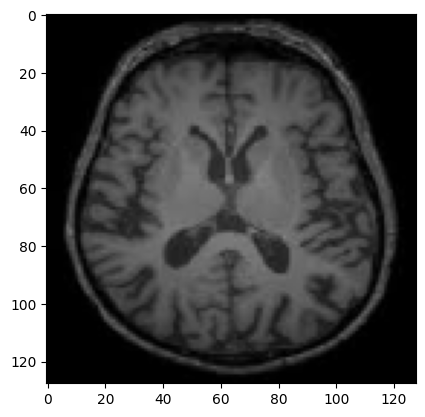

In [102]:
# Displaying the first healthy image using matplotlib
# plt.imshow() visualizes the image in a window, assuming the image is in RGB format
# This will show the image at index 0 of the 'healthy' dataset
plt.imshow(healthy[0])


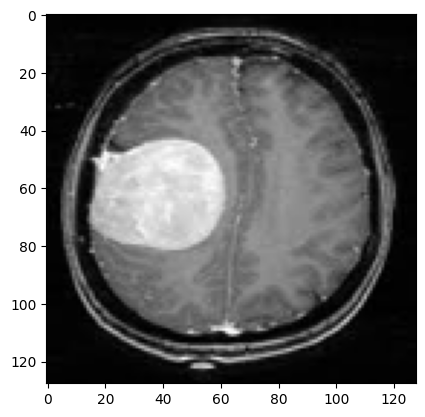

In [103]:
# Displaying the first tumor image using matplotlib
# plt.imshow() visualizes the image in a window, assuming the image is in RGB format
# This will show the image at index 0 of the 'tumor' dataset
plt.imshow(tumor[0])


In [104]:
# Function to plot a random selection of healthy and tumor images
# Arguments:
# - healthy: List or array of healthy images
# - tumor: List or array of tumor images
# - nums: The number of images to randomly plot from each category (default is 5)

def plot_random(healthy, tumor, nums=5):
    # Converting healthy and tumor lists to numpy arrays for easier indexing
    healthy = np.array(healthy)
    tumor = np.array(tumor)

    # Randomly selecting 'nums' images from the healthy dataset without replacement
    healthy_imgs = healthy[np.random.choice(healthy.shape[0], nums, replace=False)]
    
    # Randomly selecting 'nums' images from the tumor dataset without replacement
    tumor_imgs = tumor[np.random.choice(tumor.shape[0], nums, replace=False)]

    # Creating a figure with a specific size for the plot
    plt.figure(figsize=(16, 9))
    
    # Loop to plot each pair of healthy and tumor images
    for i in range(nums):
        # Plotting the healthy image on the left
        plt.subplot(2, nums, i + 1)
        plt.imshow(healthy_imgs[i], cmap='gray')  # Using grayscale colormap
        plt.title("Healthy")  # Title of the image
        plt.axis("off")  # Hides the axis for a cleaner look

        # Plotting the tumor image on the right
        plt.subplot(2, nums, nums + i + 1)
        plt.imshow(tumor_imgs[i], cmap='gray')  # Using grayscale colormap
        plt.title("Tumor")  # Title of the image
        plt.axis("off")  # Hides the axis for a cleaner look

    # Adjusts the layout to prevent overlapping
    plt.tight_layout()
    
    # Displays the plot
    plt.show()

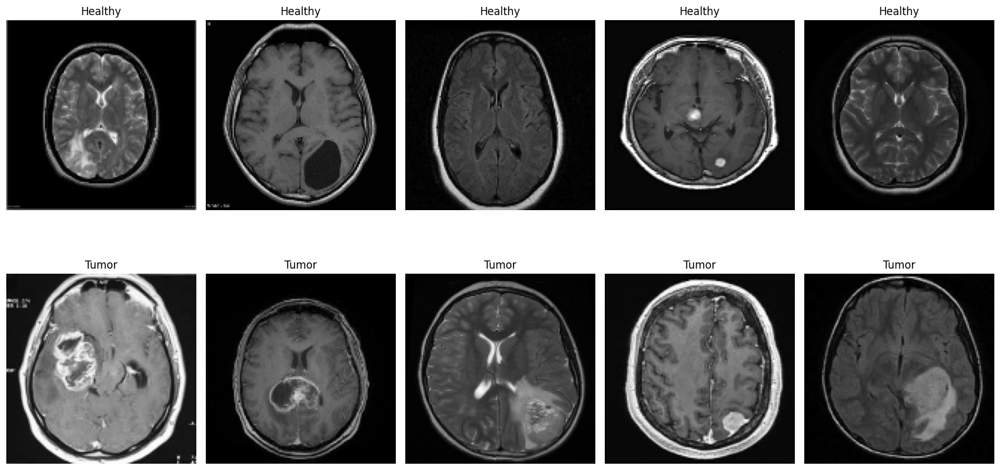

In [105]:
# Display 5 random healthy and tumor images
plot_random(healthy, tumor)


CREATE TORCH DATASET CLASS

What is Pytorch's Abstract Datset Class

In [106]:
# Custom base Dataset class
class Dataset(object):

    # Returns a single item at the given index — must be implemented in child class
    def __getitem__(self, index):
        raise NotImplementedError
    
    # Returns the total number of items — must be implemented in child class
    def __len__(self):
        raise NotImplementedError
    
    # Allows combining two datasets using the '+' operator
    def __add__(self, other):
        return ConcatDataset([self, other])


Creating MRI Custom Dataset Class


In [107]:
# MRI dataset class inheriting from custom Dataset
class MRI(Dataset):
    def __init__(self):
        tumor = []   # List to store tumor images
        healthy = [] # List to store healthy images

        # Load and process tumor images
        for f in glob.iglob(r'C:\Users\hp\Documents\GitHub\Brain-Tumor-Prediction\Images\yes\*.jpg'):
            img = cv2.imread(f)                            # Read image
            img = cv2.resize(img, (128, 128))              # Resize to 128x128
            b, g, r = cv2.split(img)                       # Split BGR channels
            img = cv2.merge([r, g, b])                     # Convert BGR to RGB
            img = img.reshape((img.shape[2], img.shape[0], img.shape[1]))  # Change to (C, H, W) format
            tumor.append(img)                              # Add to tumor list

        # Load and process healthy images (Note: using tumor path by mistake)
        for f in glob.iglob(r'C:\Users\hp\Documents\GitHub\Brain-Tumor-Prediction\Images\yes\*.jpg'):
            img = cv2.imread(f)
            img = cv2.resize(img, (128, 128))
            b, g, r = cv2.split(img)
            img = cv2.merge([r, g, b])
            img = img.reshape((img.shape[2], img.shape[0], img.shape[1]))
            healthy.append(img)

        # Convert lists to NumPy arrays with float32 type
        healthy = np.array(healthy, dtype=np.float32)
        tumor = np.array(tumor, dtype=np.float32)

        # Create labels: 1 for tumor, 0 for healthy
        tumor_label = np.ones(tumor.shape[0], dtype=np.float32)
        healthy_label = np.zeros(healthy.shape[0], dtype=np.float32)

        # Combine images and labels
        self.images = np.concatenate((tumor, healthy), axis=0)
        self.labels = np.concatenate((tumor_label, healthy_label), axis=0)

    # Return total number of samples
    def __len__(self):
        return self.images.shape[0]

    # Return a sample (image + label) at the given index
    def __getitem__(self, index):
        sample = {'image': self.images[index], 'label': self.labels[index]}
        return sample

    # Normalize image pixels to range [0, 1]
    def normalize(self):
        self.images = self.images / 255.0

In [108]:
mri = MRI()  # Creates an object of the MRI class, loading and preparing the dataset (images + labels)

In [109]:
mri.normalize()  # Normalizes all image pixel values to the range [0, 1] by dividing by 255

In [110]:
len(mri)  # Returns the total number of samples (images) in the dataset

308

In [111]:
img = mri[5]['image']  # Retrieves the image (only) from the 6th sample in the dataset (index 5)

CREATE A DATALOADER

The World Without Dataloaders

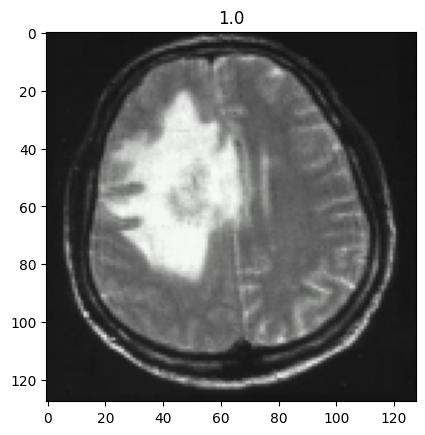

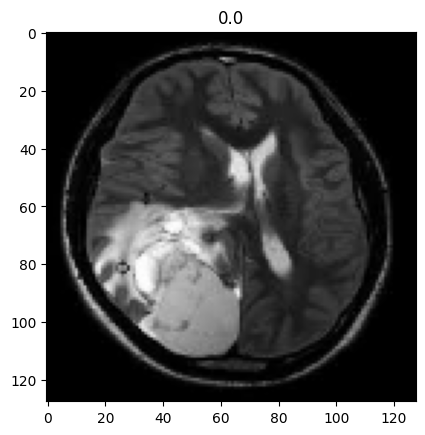

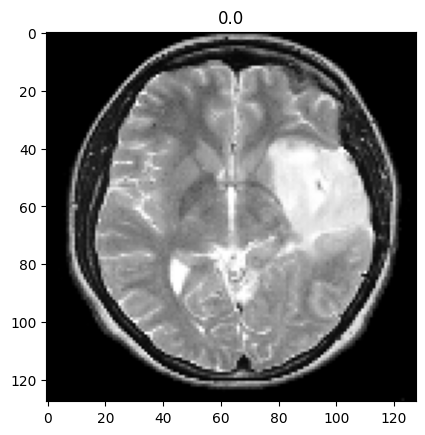

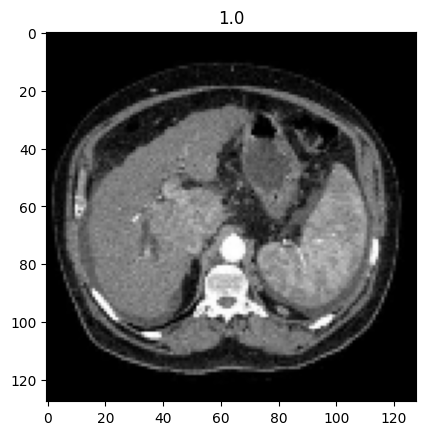

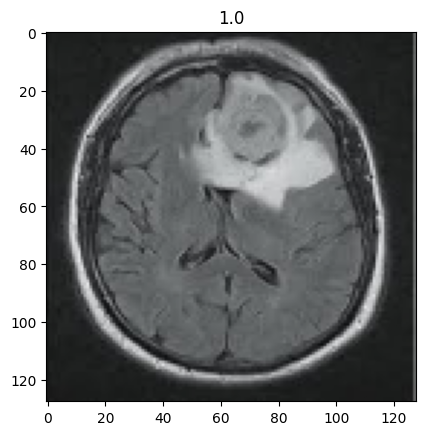

...

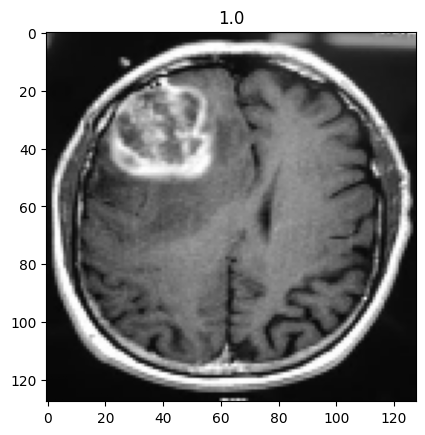

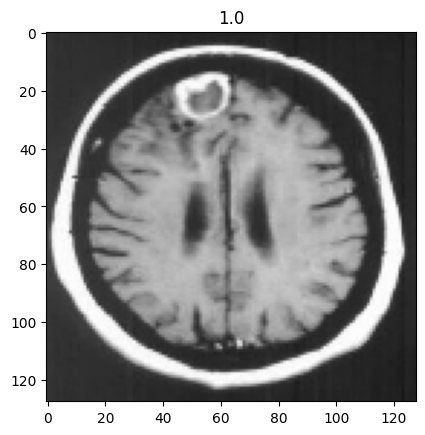

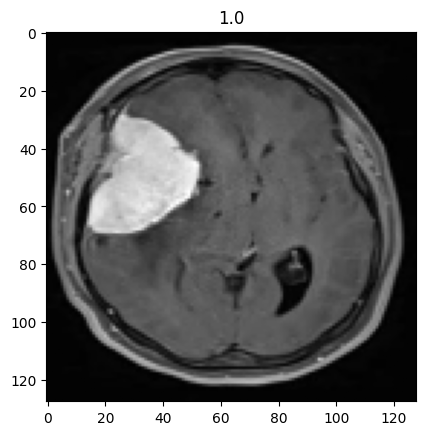

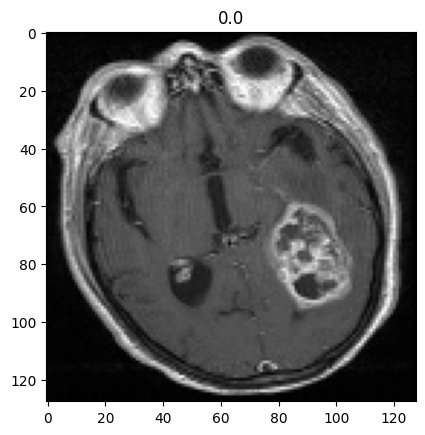

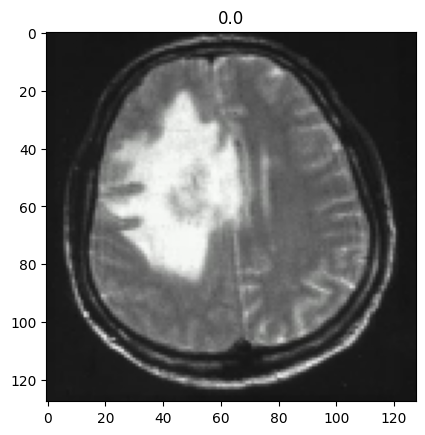

In [114]:
index = list(range(len(mri)))  # Create a list of indices representing all samples in the MRI dataset
random.shuffle(index)  # Shuffle the indices to display images in a random order

for idx in index:  # Iterate over the shuffled indices
    sample = mri[idx]  # Get the sample (image and label) at the current index
    img = sample['image']  # Extract the image from the sample
    label = sample['label']  # Extract the label from the sample
    img = img.reshape(img.shape[1], img.shape[2], img.shape[0])  # Reshape the image back to (H, W, C) format for displaying
    plt.title(label)  # Set the title of the plot as the image label (0 for healthy, 1 for tumor)
    plt.imshow(img)  # Display the image using matplotlib
    plt.show()  # Show the image plot

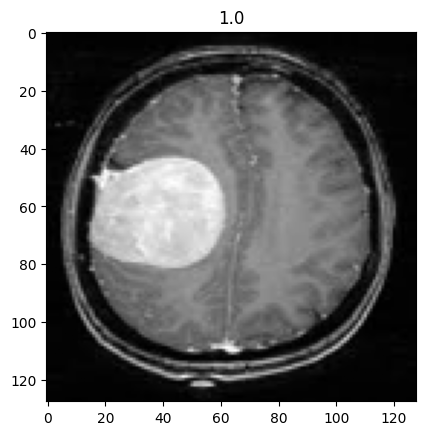

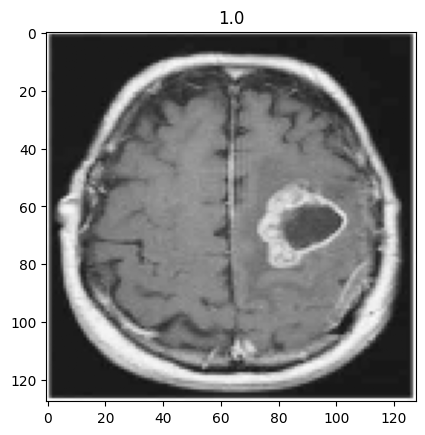

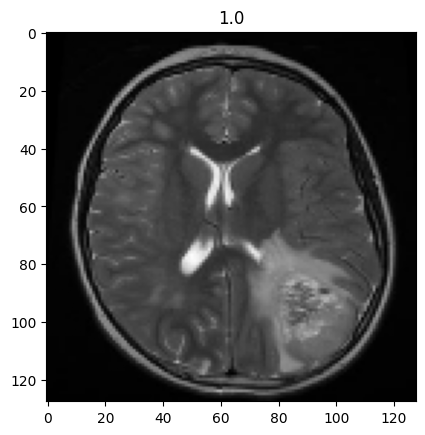

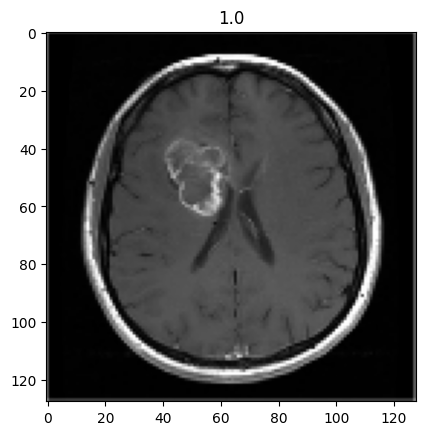

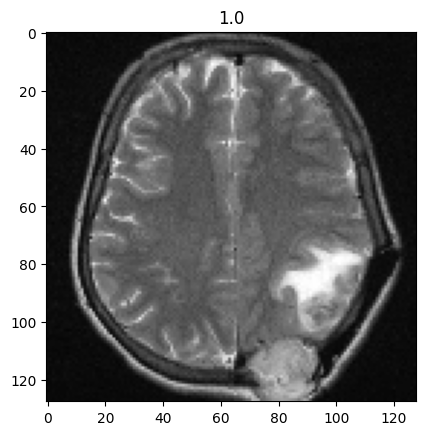

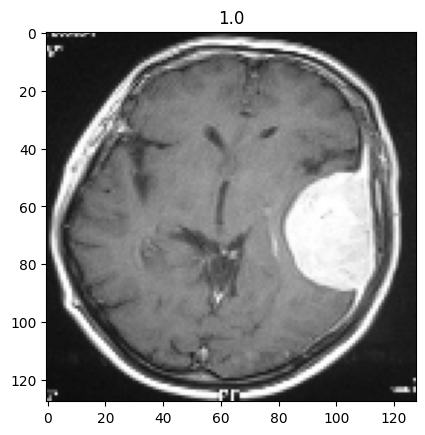

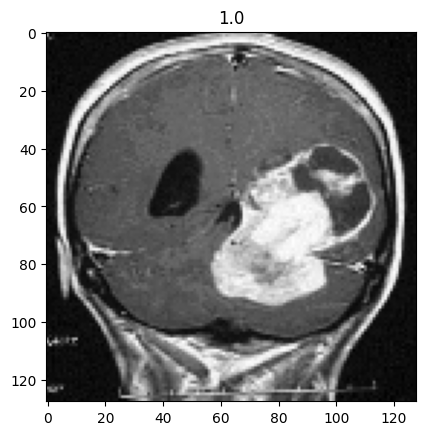

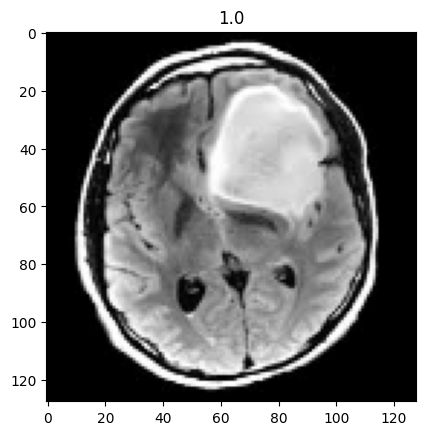

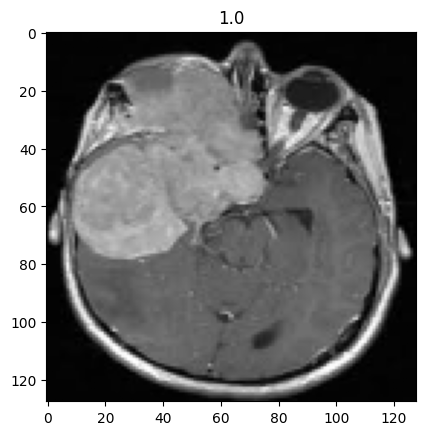

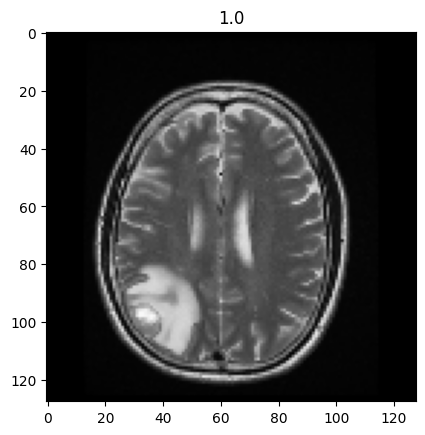

In [201]:
it = iter(mri)  # Create an iterator for the MRI dataset

for i in range(10):  # Loop through the first 10 samples in the dataset
    sample = next(it)  # Get the next sample using the iterator
    img = sample['image']  # Extract the image from the sample
    label = sample['label']  # Extract the label (0 for tumor, 1 for healthy)
    img = img.reshape(img.shape[1], img.shape[2], img.shape[0])  # Reshape image to (H, W, C) format for visualization
    plt.title(label)  # Set the label as the title of the image
    plt.imshow(img)  # Display the image using matplotlib
    plt.show()  # Render the image

The World With Dataloaders

In [116]:
# Assuming `mri` is a dataset object and it contains 'image' and 'label'
dataloader = DataLoader(mri, batch_size=10, shuffle=True)  # DataLoader with batch size of 10

In [117]:
import torch.nn as nn
import torch.nn.functional as F

class CNN(nn.Module):
    def __init__(self):

        super(CNN, self).__init__()

        self.cnn_model = nn.Sequential(
            nn.Conv2d(in_channels = 3, out_channels = 6, kernel_size = 5),
            nn.Tanh(),
            nn.AvgPool2d(kernel_size = 2, stride = 5),
            nn.Conv2d(in_channels = 6, out_channels = 16, kernel_size = 5),
            nn.Tanh(),
            nn.AvgPool2d(kernel_size = 2, stride = 5)
        )

        self.fc_model = nn.Sequential(
            nn.Linear(in_features = 256, out_features= 120),
            nn.Tanh(),
            nn.Linear(in_features = 120, out_features = 84),
            nn.Tanh(),
            nn.Linear(in_features = 84, out_features = 1)
            )
        
    def forward(self, x):

        x = self.cnn_model(x)
        x = x.view(x.size(0), -1)
        x = self.fc_model(x)
        x = F.sigmoid(x)

        return x



***CNN CLASS***

***LOOKING AT THE PARAMETERS OF THE MODEL*** 

In [118]:
model=CNN()
model

CNN(
  (cnn_model): Sequential(
    (0): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))
    (1): Tanh()
    (2): AvgPool2d(kernel_size=2, stride=5, padding=0)
    (3): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))
    (4): Tanh()
    (5): AvgPool2d(kernel_size=2, stride=5, padding=0)
  )
  (fc_model): Sequential(
    (0): Linear(in_features=256, out_features=120, bias=True)
    (1): Tanh()
    (2): Linear(in_features=120, out_features=84, bias=True)
    (3): Tanh()
    (4): Linear(in_features=84, out_features=1, bias=True)
  )
)

In [119]:
model.cnn_model[0]

Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))

In [120]:
model.cnn_model[0].weight

Parameter containing:
tensor([[[[-0.0482,  0.1088,  0.0703,  0.0759,  0.0064],
          [-0.0490, -0.0889, -0.0014,  0.0921,  0.0856],
          [ 0.0593, -0.1036, -0.0828,  0.1059, -0.0951],
          [-0.0043,  0.0436, -0.0539,  0.0585, -0.0982],
          [ 0.1034,  0.1031,  0.1118, -0.0691, -0.0373]],

         [[-0.0254, -0.0744, -0.0935,  0.0142, -0.1090],
          [ 0.1146,  0.1025,  0.1130,  0.0687,  0.0275],
          [-0.0566, -0.0916,  0.0464, -0.0378, -0.0324],
          [ 0.0830,  0.1079,  0.0122, -0.0695,  0.0037],
          [-0.1039,  0.0121, -0.0798, -0.0485,  0.0142]],

         [[ 0.0930, -0.0925, -0.1022, -0.0591, -0.0599],
          [-0.0437,  0.0859,  0.0222,  0.0984,  0.0216],
          [ 0.1142, -0.0839,  0.0430,  0.0185, -0.0061],
          [-0.0479, -0.0792,  0.0824, -0.1052,  0.1104],
          [-0.0966,  0.0028, -0.0039,  0.0412, -0.0740]]],


        [[[-0.0027,  0.1047,  0.0440,  0.1069,  0.0062],
          [ 0.0075, -0.0289,  0.0180,  0.0295, -0.0208],
 

In [130]:
model.cnn_model[0].weight.shape

torch.Size([6, 3, 5, 5])

In [131]:
model.cnn_model[0].weight[0][0]

tensor([[-0.0482,  0.1088,  0.0703,  0.0759,  0.0064],
        [-0.0490, -0.0889, -0.0014,  0.0921,  0.0856],
        [ 0.0593, -0.1036, -0.0828,  0.1059, -0.0951],
        [-0.0043,  0.0436, -0.0539,  0.0585, -0.0982],
        [ 0.1034,  0.1031,  0.1118, -0.0691, -0.0373]],
       grad_fn=<SelectBackward0>)

In [132]:
model.fc_model

Sequential(
  (0): Linear(in_features=256, out_features=120, bias=True)
  (1): Tanh()
  (2): Linear(in_features=120, out_features=84, bias=True)
  (3): Tanh()
  (4): Linear(in_features=84, out_features=1, bias=True)
)

In [133]:
model.fc_model[0]

Linear(in_features=256, out_features=120, bias=True)

In [134]:
model.fc_model[0].weight.shape

torch.Size([120, 256])

**Understanding x.view(x.size(0),-1)**

In [122]:
x=torch.tensor([1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16])

In [123]:
x = x.reshape(2, 2, 2, 2)

In [124]:
x

tensor([[[[ 1,  2],
          [ 3,  4]],

         [[ 5,  6],
          [ 7,  8]]],


        [[[ 9, 10],
          [11, 12]],

         [[13, 14],
          [15, 16]]]])

In [125]:
x.size(0)

2

In [135]:
x.view(x.size(0), -1)

tensor([[ 1,  2,  3,  4,  5,  6,  7,  8],
        [ 9, 10, 11, 12, 13, 14, 15, 16]])

In [136]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

**Evaluate a New-Born Neural Network**

In [138]:
mri_dataset = MRI()
mri_dataset.normalize()
device = torch.device('cuda:0')
model = CNN().to(device)


In [139]:
dataloader=DataLoader(mri_dataset,batch_size=32,shuffle=False)

In [ ]:
model.eval()
outputs = []
y_true = []

with torch.no_grad():
    for D in dataloader:
        image = D['image'].to(device)
        label = D['label'].to(device)

        y_hat = model(image)

        outputs.append(y_hat.cpu().detach().numpy())
        y_true.append(label.cpu().detach().numpy())

In [141]:
outputs = np.concatenate( outputs, axis=0).squeeze()
y_true = np.concatenate( y_true, axis=0).squeeze()

In [151]:
def threshold(scores, threshold=0.50, minimum=0, maximum=1.0):
    x = np.array(list(scores))
    x[x >= threshold] = maximum
    x[x <= threshold] = minimum
    return x

In [152]:
accuracy_score(y_true, threshold(outputs))

0.5

[Text(0, 0.5, 'Tumor'), Text(0, 1.5, 'Healthy')]

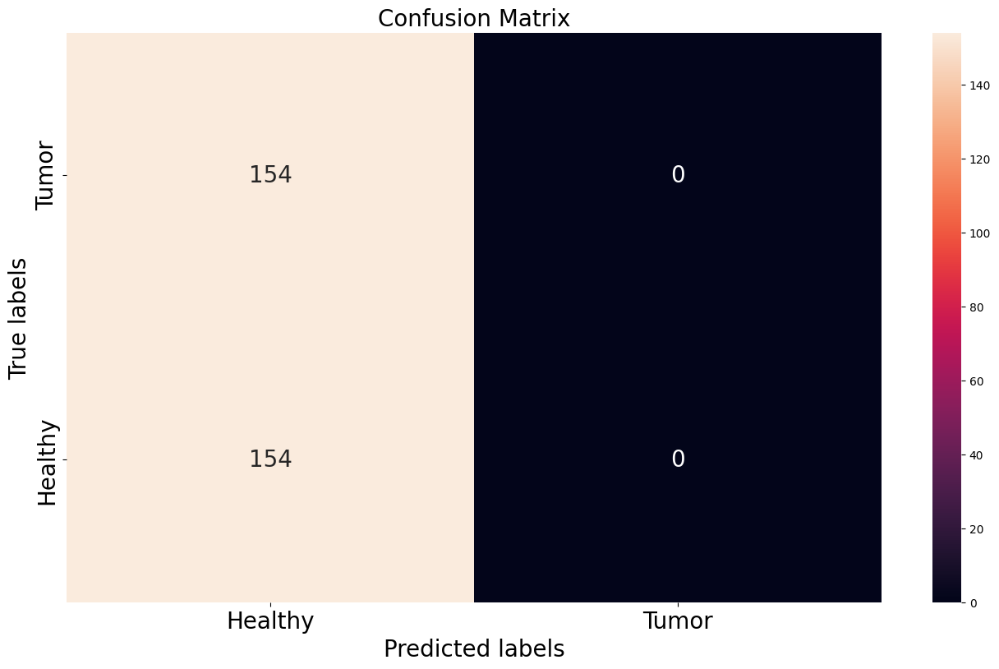

In [153]:
import seaborn as sns

plt.figure(figsize=(16, 9))
cm = confusion_matrix(y_true, threshold(outputs))
ax = plt.subplot()
sns.heatmap(cm, annot=True, fmt='g', ax=ax, annot_kws={"size": 20})

ax.set_xlabel('Predicted labels', fontsize=20)
ax.set_ylabel('True labels', fontsize=20)
ax.set_title('Confusion Matrix', fontsize=20)

ax.xaxis.set_ticklabels(['Healthy', 'Tumor'], fontsize=20)
ax.yaxis.set_ticklabels(['Tumor', 'Healthy'], fontsize=20)



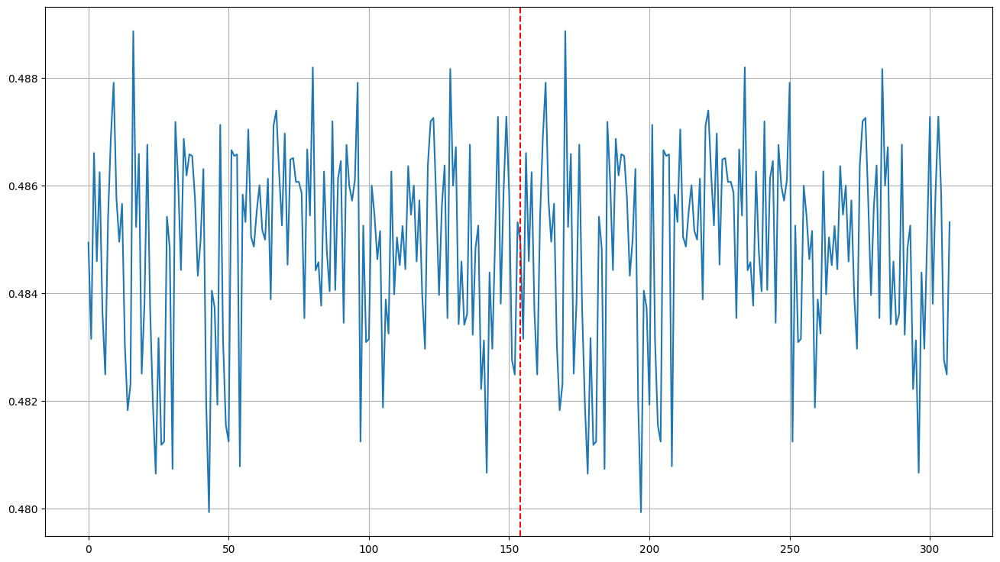

In [154]:
plt.figure(figsize=(16, 9))
plt.plot(outputs)
plt.axvline(x=len(tumor), color='r', linestyle='--')
plt.grid()


**TRAIN THE DUMB MODEL**

In [156]:
eta = 0.0001
EPOCH = 400

optimizer = torch.optim.Adam(model.parameters(), lr=eta)
dataloader = DataLoader(mri_dataset, batch_size=32, shuffle= True)

model.train()



CNN(
  (cnn_model): Sequential(
    (0): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))
    (1): Tanh()
    (2): AvgPool2d(kernel_size=2, stride=5, padding=0)
    (3): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))
    (4): Tanh()
    (5): AvgPool2d(kernel_size=2, stride=5, padding=0)
  )
  (fc_model): Sequential(
    (0): Linear(in_features=256, out_features=120, bias=True)
    (1): Tanh()
    (2): Linear(in_features=120, out_features=84, bias=True)
    (3): Tanh()
    (4): Linear(in_features=84, out_features=1, bias=True)
  )
)

In [157]:
for epoch in range(1, EPOCH):
    losses = []
    for D in dataloader:
        optimizer.zero_grad()
        data = D['image'].to(device)
        label = D['label'].to(device)
        y_hat = model(data)

        error = nn.BCELoss()
        loss = torch.sum(error(y_hat.squeeze(), label))
        loss.backward()
        optimizer.step()

        losses.append(loss.item())

    if (epoch+1) % 10 == 0:
        print("Train Epoch: {}\tLoss: {:.6f}".format(epoch+1, np.mean(losses)))

Train Epoch: 10	Loss: 0.693260
Train Epoch: 20	Loss: 0.693313
Train Epoch: 30	Loss: 0.693296
Train Epoch: 40	Loss: 0.693261
Train Epoch: 50	Loss: 0.693227
Train Epoch: 60	Loss: 0.693308
Train Epoch: 70	Loss: 0.693276
Train Epoch: 80	Loss: 0.693231
Train Epoch: 90	Loss: 0.693194
Train Epoch: 100	Loss: 0.693251
Train Epoch: 110	Loss: 0.693210
Train Epoch: 120	Loss: 0.693219
Train Epoch: 130	Loss: 0.693632
Train Epoch: 140	Loss: 0.693230
Train Epoch: 150	Loss: 0.693166
Train Epoch: 160	Loss: 0.693260
Train Epoch: 170	Loss: 0.693278
Train Epoch: 180	Loss: 0.693253
Train Epoch: 190	Loss: 0.693229
Train Epoch: 200	Loss: 0.693182
Train Epoch: 210	Loss: 0.693187
Train Epoch: 220	Loss: 0.693184
Train Epoch: 230	Loss: 0.693193
Train Epoch: 240	Loss: 0.693224
Train Epoch: 250	Loss: 0.693220
Train Epoch: 260	Loss: 0.693176
Train Epoch: 270	Loss: 0.693220
Train Epoch: 280	Loss: 0.693158
Train Epoch: 290	Loss: 0.693233
Train Epoch: 300	Loss: 0.693194
Train Epoch: 310	Loss: 0.693210
Train Epoch: 320	

**Evaluate the smart model**

In [159]:

model.eval()
dataloader = DataLoader(mri_dataset, batch_size=32, shuffle=False)
outputs=[]
y_true = []
with torch.no_grad():
    for D in dataloader:
        image =  D['image'].to(device)
        label = D['label'].to(device)
        
        y_hat = model(image)
        
        outputs.append(y_hat.cpu().detach().numpy())
        y_true.append(label.cpu().detach().numpy())
        
outputs = np.concatenate( outputs, axis=0 )
y_true = np.concatenate( y_true, axis=0 )


In [160]:
accuracy_score(y_true, threshold(outputs))

0.5

[Text(0, 0.5, 'Tumor'), Text(0, 1.5, 'Healthy')]

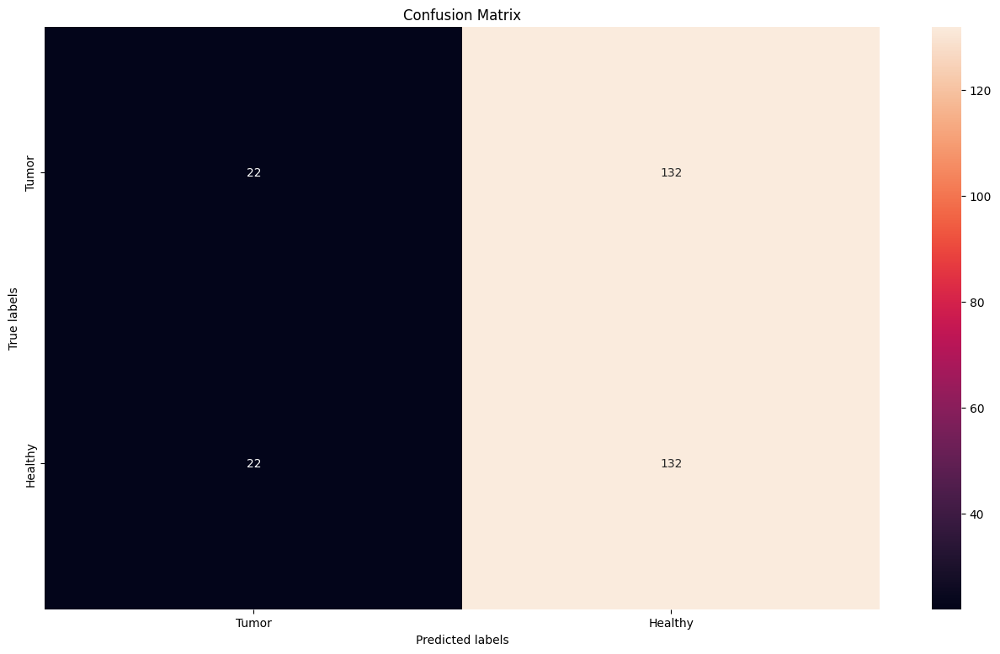

In [161]:
cm = confusion_matrix(y_true, threshold(outputs))
plt.figure(figsize=(16,9))

ax= plt.subplot()
sns.heatmap(cm, annot=True, fmt='g', ax=ax);  #annot=True to annotate cells, ftm='g' to disable scientific notation

# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['Tumor','Healthy'])
ax.yaxis.set_ticklabels(['Tumor','Healthy'])

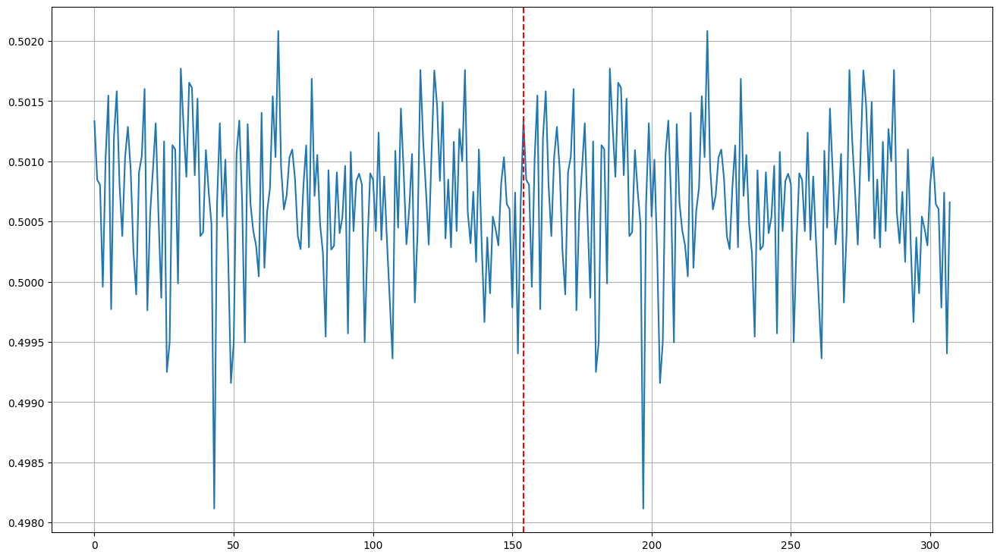

In [162]:
plt.figure(figsize=(16,9))
plt.plot(outputs)
plt.axvline(x=len(tumor), color='r', linestyle='--')
plt.grid()

***Visualising the Feature Maps of the Convolutional Filters***

In [163]:
model

CNN(
  (cnn_model): Sequential(
    (0): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1))
    (1): Tanh()
    (2): AvgPool2d(kernel_size=2, stride=5, padding=0)
    (3): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))
    (4): Tanh()
    (5): AvgPool2d(kernel_size=2, stride=5, padding=0)
  )
  (fc_model): Sequential(
    (0): Linear(in_features=256, out_features=120, bias=True)
    (1): Tanh()
    (2): Linear(in_features=120, out_features=84, bias=True)
    (3): Tanh()
    (4): Linear(in_features=84, out_features=1, bias=True)
  )
)

In [172]:
no_of_layers = 0
conv_layers = []

In [173]:
model_children = list(model.children())

In [174]:
for child in model_children:
    if type(child) == nn.Sequential:
        for layer in child.children():
            if type(layer) == nn.Conv2d:
                no_of_layers += 1
                conv_layers.append(layer)


In [175]:
conv_layers[1]

Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))

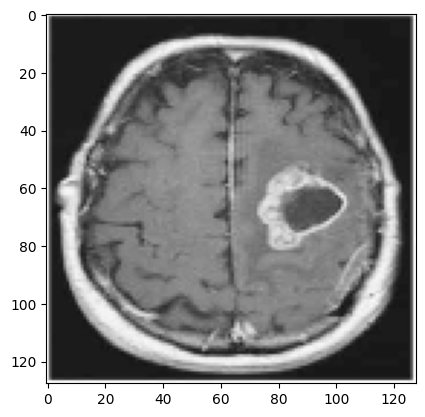

In [176]:
img = mri_dataset[100]['image']
plt.imshow(img.reshape(128,128,3))

In [177]:
img = torch.from_numpy(img).to(device)

In [178]:
img.shape

torch.Size([3, 128, 128])

In [179]:
img = img.unsqueeze(0)
img.shape

torch.Size([1, 3, 128, 128])

In [180]:
results = [conv_layers[0](img )]
for i in range(1, len(conv_layers)):
    results.append(conv_layers[i](results[-1]))

outputs = results

In [181]:
len(outputs)

2

In [182]:
outputs[0].shape

torch.Size([1, 6, 124, 124])

In [183]:
outputs[1].shape

torch.Size([1, 16, 120, 120])

Layer  1


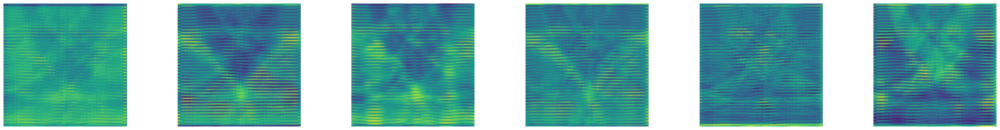

Layer  2


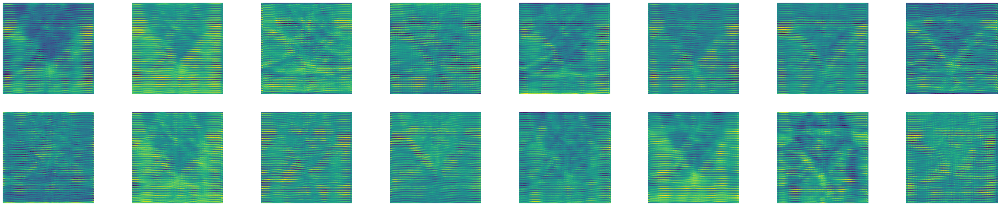

In [184]:
for num_layer in range(len(outputs)):
    plt.figure(figsize=(50, 10))
    layer_viz = outputs[num_layer].squeeze()
    print("Layer ",num_layer+1)
    for i, f in enumerate(layer_viz):
        plt.subplot(2, 8, i + 1)
        plt.imshow(f.detach().cpu().numpy())
        plt.axis("off")
    plt.show()
    plt.close()

In [185]:
from sklearn.model_selection import train_test_split

In [193]:
class MRI(Dataset):
    
    def __init__(self):
        
        # Variables to hold the Training data and Validation data
        self.X_train, self.y_train, self.X_val, self.y_val = None, None, None, None
        
        # A variable to determine if we are interested in retrieving the training OR the validation data
        self.mode = 'train'
        
        tumor = []
        healthy = []
        # cv2 - It reads in BGR format by default
        for f in glob.iglob(r'C:\Users\hp\Documents\GitHub\Brain-Tumor-Prediction\Images\yes\*.jpg'):
            img = cv2.imread(f)
            img = cv2.resize(img,(128,128)) # I can add this later in the boot-camp for more adventure
            b, g, r = cv2.split(img)
            img = cv2.merge([r,g,b])
            img = img.reshape((img.shape[2],img.shape[0],img.shape[1])) # otherwise the shape will be (h,w,#channels)
            tumor.append(img)

        for f in glob.iglob(r'C:\Users\hp\Documents\GitHub\Brain-Tumor-Prediction\Images\no\*.jpg'):
            img = cv2.imread(f)
            img = cv2.resize(img,(128,128)) 
            b, g, r = cv2.split(img)
            img = cv2.merge([r,g,b])
            img = img.reshape((img.shape[2],img.shape[0],img.shape[1]))
            healthy.append(img)

        # our images
        tumor = np.array(tumor,dtype=np.float32)
        healthy = np.array(healthy,dtype=np.float32)
        
        # our labels
        tumor_label = np.ones(tumor.shape[0], dtype=np.float32)
        healthy_label = np.zeros(healthy.shape[0], dtype=np.float32)
        
        # Concatenates
        self.images = np.concatenate((tumor, healthy), axis=0)
        self.labels = np.concatenate((tumor_label, healthy_label))
    
    # Define a function that would separate the data into Training and Validation sets
    def train_val_split(self):
        self.X_train, self.X_val, self.y_train, self.y_val = \
        train_test_split(self.images, self.labels, test_size=0.20, random_state=42)
        
    def __len__(self):
        # Use self.mode to deetrmine whether train or val data is of interest
        if self.mode == 'train':
            return self.X_train.shape[0]
        elif self.mode == 'val':
            return self.X_val.shape[0]
    
    def __getitem__(self, idx):
        # Use self.mode to deetrmine whether train or val data is of interest
        if self.mode== 'train':
            sample = {'image': self.X_train[idx], 'label': self.y_train[idx]}
        
        elif self.mode== 'val':
            sample = {'image': self.X_val[idx], 'label': self.y_val[idx]}
        
        return sample
    
    def normalize(self):
        self.images = self.images/255.0

In [194]:
mri_dataset = MRI()
mri_dataset.normalize()
mri_dataset.train_val_split()

In [195]:
train_dataloader = DataLoader(mri_dataset, batch_size=32, shuffle=True)
val_dataloader = DataLoader(mri_dataset, batch_size=32, shuffle=False)

In [196]:
device = torch.device("cuda:0")
model = CNN().to(device)

In [197]:
eta=0.0001
optimizer = torch.optim.Adam(model.parameters(), lr=eta)

In [198]:
epoch_train_loss = []
epoch_val_loss = []

In [199]:
for epoch in range(1,600):
    train_losses = []
    # train for the current epoch
    model.train()
    mri_dataset.mode = 'train'
    for D in train_dataloader:
        # Train the model
        optimizer.zero_grad()
        data = D['image'].to(device)
        label = D['label'].to(device)
        
        y_hat = model(data)
        error = nn.BCELoss()
        loss = torch.sum(error(y_hat.squeeze(), label))
        loss.backward()
        optimizer.step()
        train_losses.append(loss.item())
    
    epoch_train_loss.append(np.mean(train_losses))
    
    # validate for the current epoch
    val_losses = []
    model.eval()
    
    mri_dataset.mode = 'val'
    
    with torch.no_grad():
        for D in val_dataloader:            
            data = D['image'].to(device)
            label = D['label'].to(device)
            y_hat = model(data)
            error = nn.BCELoss()
            loss = torch.sum(error(y_hat.squeeze(), label))
            val_losses.append(loss.item())
    
    epoch_val_loss.append(np.mean(val_losses))
    
    if (epoch+1) % 10 == 0:
        print('Train Epoch: {}\tTrain Loss: {:.6f}\tVal Loss: {:.6f}'.format(epoch+1, np.mean(train_losses),np.mean(val_losses)))

Train Epoch: 10	Train Loss: 0.643951	Val Loss: 0.597921
Train Epoch: 20	Train Loss: 0.639245	Val Loss: 0.568016
Train Epoch: 30	Train Loss: 0.548739	Val Loss: 0.556361
Train Epoch: 40	Train Loss: 0.561192	Val Loss: 0.553192
Train Epoch: 50	Train Loss: 0.519793	Val Loss: 0.561240
Train Epoch: 60	Train Loss: 0.527142	Val Loss: 0.555541
Train Epoch: 70	Train Loss: 0.499580	Val Loss: 0.568797
Train Epoch: 80	Train Loss: 0.470829	Val Loss: 0.589950
Train Epoch: 90	Train Loss: 0.484796	Val Loss: 0.586834
Train Epoch: 100	Train Loss: 0.419737	Val Loss: 0.602742
Train Epoch: 110	Train Loss: 0.391173	Val Loss: 0.621687
Train Epoch: 120	Train Loss: 0.404983	Val Loss: 0.626392
Train Epoch: 130	Train Loss: 0.408681	Val Loss: 0.623621
Train Epoch: 140	Train Loss: 0.435941	Val Loss: 0.644882
Train Epoch: 150	Train Loss: 0.421155	Val Loss: 0.638321
Train Epoch: 160	Train Loss: 0.362199	Val Loss: 0.650990
Train Epoch: 170	Train Loss: 0.350760	Val Loss: 0.670635
Train Epoch: 180	Train Loss: 0.343781	Va

Text(0, 0.5, 'Loss')

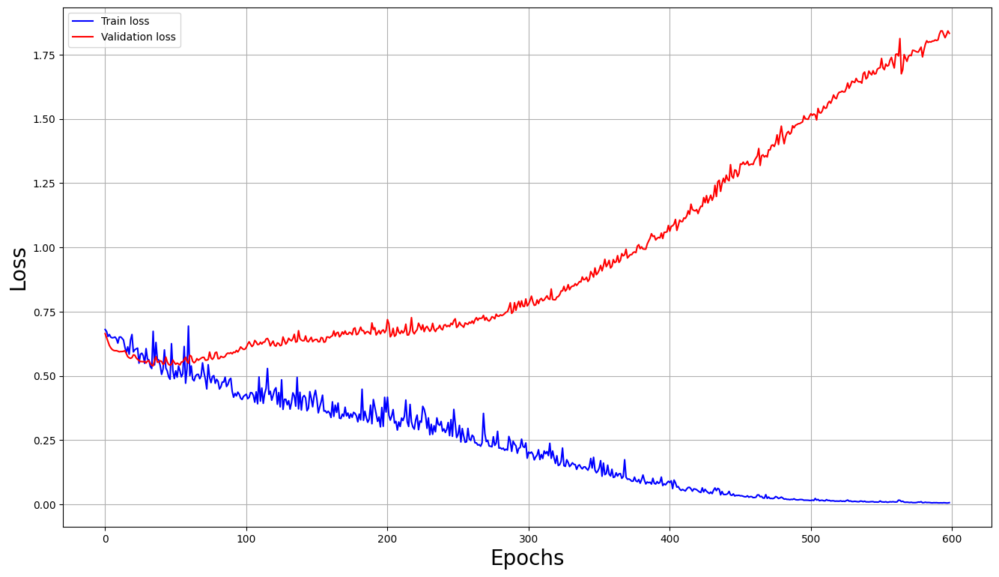

In [200]:
plt.figure(figsize=(16,9))
plt.plot(epoch_train_loss, c='b', label='Train loss')
plt.plot(epoch_val_loss, c='r', label = 'Validation loss')
plt.legend()
plt.grid()
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('Loss', fontsize=20)